In [1]:
import datetime
import calendar
import pandas as pd
#pd.set_option('display.max_columns', None)
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
# import missingno as msno
%matplotlib inline
%load_ext nb_black

<IPython.core.display.Javascript object>

# Processing raw data.

Read in the csv data.

In [2]:
iwar = pd.read_csv('inactive_wells_table3.csv')
orphans = pd.read_csv('orphans_table2.csv')
operators = pd.read_csv('operators_table2.csv')
parse_dates = ['shutin_dt', 'compliance_due_date', 'orig_completion', 'ice_inspection_date']
df = pd.read_csv('orphanwells_join_inactive_wells6.csv', dtype={'og_code': str, 'operator_name': str, 'operator_no': str, 'lease_name': str, 'lease_no': str, 'well_no': str, 'api': str, 'district': str, 'county': str, 'field_name': str, 'field_no': str, 'oil_unit_no': str, 'water_land_code': str, 'api_depth': 'Int64', 'shutin_dt': str, 'well_plugged': str, 'cost_calc': 'Int64', 'compliance_due_date': str, 'orig_completion': str, 'ice_inspection_date': str, 'ice_inspection_id': str, 'sfp_code': str, 'ofcu_well_priority': str, 'sb639_enf': str, 'sb639_r15': str, 'months_delinquent': 'Int64', 'p5_renewal_month': 'Int64', 'p5_renewal_year': 'Int64', 'p5_originating_status': str, 'current_5yr_inactive': str, 'current_10yr_inactive': str, 'aged_5yr_inactive': str, 'aged_10yr_inactive': str, 'current_inactive_yrs': 'Int64', 'current_inactive_months': 'Int64', 'aged_inactive_yrs': 'Int64', 'aged_inactive_months': 'Int64', 'extension_status': str, 'ext_data_h': str, 'ext_data_e': str, 'ext_data_p': str, 'ext_data_f': str, 'ext_data_v': str, 'ext_data_x': str, 'ext_data_o': str, 'ext_data_t': str, 'ext_data_m': str, 'ext_data_k': str, 'ext_data_r': str, 'ext_data_q': str, 'ext_data_s': str, 'ext_data_w': str}, parse_dates=parse_dates)
oil_prices = pd.read_csv('oil_prices_table.csv')
oil_prices['date'] = pd.to_datetime(oil_prices['date'])
gas_prices = pd.read_csv('gas_prices_table.csv')
gas_prices['date'] = pd.to_datetime(gas_prices['date'])
gas_prices = gas_prices.sort_values(by=['date'])

<IPython.core.display.Javascript object>

Read in the active wells data.

In [3]:
# active_wells = pd.read_csv('OG_WELLBORE_EWA_Report.csv', delimiter=',', header=None)
# active_wells

<IPython.core.display.Javascript object>

Convert columns to booleans where appropriate, drop some rows that have null values.

In [4]:
convert = {'t': True, 'f': False}
bool_columns = ['well_plugged', 'current_5yr_inactive', 'current_10yr_inactive', 'aged_5yr_inactive', 'aged_10yr_inactive']

df['oil_unit_no'].fillna('None', inplace=True)
# Fill nans with dummy value and replace with False (boolean) later
df['sb639_enf'].fillna('N', inplace=True)
df['sb639_r15'].fillna('N', inplace=True)

# Oil wells are labeled with True (1), gas wells are labeled with False (0)
df['og_code'] = df['og_code'].replace({'O': True, 'G': False})

df = df[df['api_depth'].notna()]
df = df[df['ice_inspection_id'].notna()]

<IPython.core.display.Javascript object>

Convert columns to boolean types for later encoding.

In [5]:
for col in df.columns:
    if 'ext_data' in col or col in bool_columns:
        df[col] = df[col].map(convert)
    elif str(col) == 'sb639_enf':
        df[col] = df[col].map({'Enf': True, 'N': False})
    elif str(col) == 'sb639_r15':
        df[col] = df[col].map({'Rule 15': True, 'N': False}) 

<IPython.core.display.Javascript object>

Examine current distributions of original completion dates and shut in dates for orphan wells.

<AxesSubplot:title={'center':'Distribution of Original Completion Dates'}, xlabel='Date', ylabel='Density'>

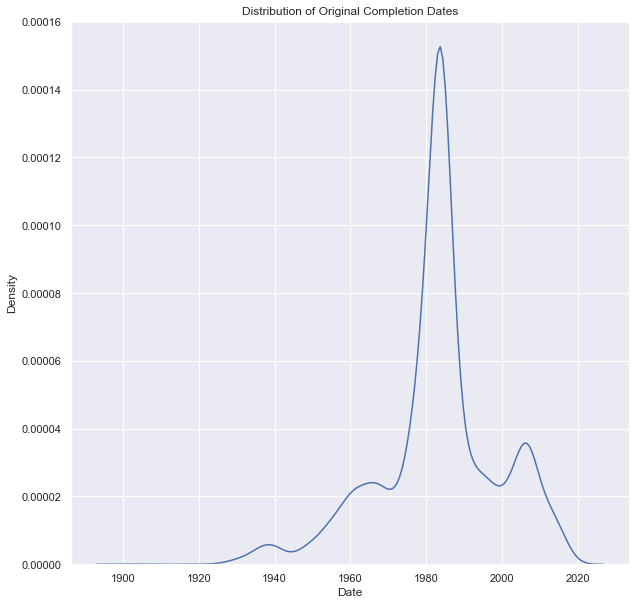

<IPython.core.display.Javascript object>

In [6]:
plt.figure(figsize=(10, 10))
plt.title('Distribution of Original Completion Dates')
plt.xlabel('Date')
sns.kdeplot(data=df['orig_completion'])
#plt.savefig('figs/orig_completion_distr_preprocess.png', bbox_inches='tight')

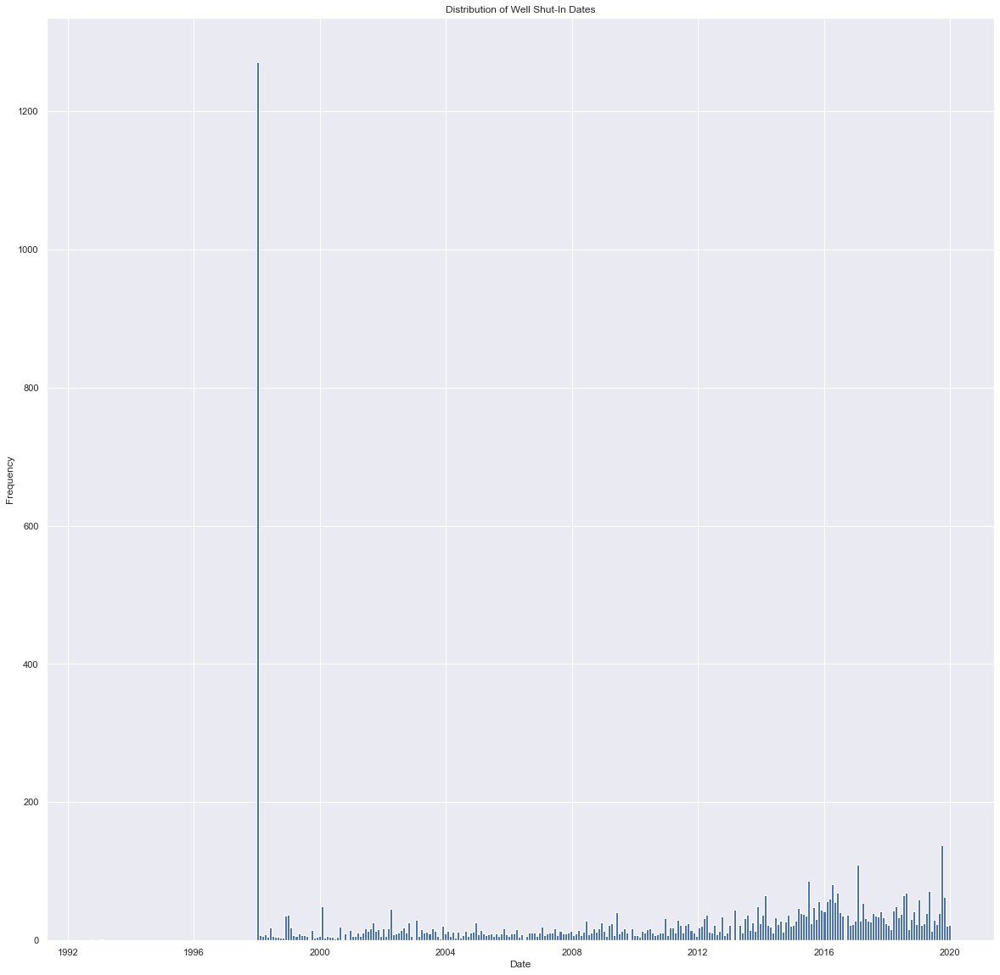

<IPython.core.display.Javascript object>

In [7]:
plt.figure(figsize=(20, 20))
plt.title('Distribution of Well Shut-In Dates')
plt.ylabel('Frequency')
plt.xlabel('Date')
plt.hist(df['shutin_dt'], bins=336)
plt.savefig('figs/shutin_dt_distr_preprocess.png', bbox_inches='tight')

Based on the distributions of original completions and shut in dates, remove data from 1998 (all shut-in dates older than 1998 were assigned to the same year, not good for data analysis) as well as 1984 (likely a similar situation with the recored dates).

In [8]:
indexes = []
for i, row in df.iterrows():
    if (datetime.datetime.fromisoformat(str(row['shutin_dt'])).strftime('%Y') == '1998') or (datetime.datetime.fromisoformat(str(row['orig_completion'])).strftime('%m/%d/%Y') == '01/12/1984'):
        indexes.append(i)

<IPython.core.display.Javascript object>

In [9]:
df = df.drop(indexes)
df.reset_index(inplace=True)
df = df.drop('index', axis=1)

<IPython.core.display.Javascript object>

Calculate the total days active and add as a new column.

In [10]:
df['days_active'] = (df['shutin_dt'] - df['orig_completion']).dt.days

<IPython.core.display.Javascript object>

In [11]:
df['days_active'] = df['days_active'].astype('Int64')

<IPython.core.display.Javascript object>

Handle negative days active. If the original completion date is more recent than the shut in date, then the record is assumed to not be useful and is dropped. However, if the original completion date and shut in date are both within the same month, the shut in date (which is given by the RRC only as a month and year) is assigned to the last day of the month and the non-negative difference between the two dates is then calculated and used in the 'days_active' column.

In [12]:
df[df['days_active'] <= 0]

,og_code,operator_name,operator_no,lease_name,lease_no,well_no,api,district,county,field_name,...,ext_data_x,ext_data_o,ext_data_t,ext_data_m,ext_data_k,ext_data_r,ext_data_q,ext_data_s,ext_data_w,days_active
137,True,"ALPHA GAMMA ONSHORE, LLC",015112,BROWN SOUTH,31952,3371,44736638,7B,THROCKMORTON,SWENSON (CADDO),...,False,True,False,False,False,False,False,False,False,-4
216,True,HIDALGO OIL & EXPLORATION CORP.,385390,CLARA,18380,2,39935380,7C,RUNNELS,DEANIE B. (JENNINGS SD.),...,False,True,False,False,False,False,False,False,False,0
260,True,"ARABELLA OPERATING, LLC",028704,ALLAR STATE,47069,1,38934233,08,REEVES,WOLFBONE (TREND AREA),...,False,True,False,False,False,False,False,False,False,-15
363,True,"PROGAS OPERATING, INC",681142,CANALES,13865,1H,24902340,04,JIM WELLS,PREMONT (BARNSDALL SAND),...,False,True,False,False,False,False,False,False,False,-15
365,True,"PROGAS OPERATING, INC",681142,CANALES,13865,3,24932617,04,JIM WELLS,PREMONT (BARNSDALL SAND),...,False,True,False,False,False,False,False,False,False,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4438,False,"PERRYMAN EXP. AND PROD., LLC",657295,TRINITY MATERIALS,187842,1,21330839,05,HENDERSON,WILDCAT,...,False,True,False,False,False,False,False,False,False,-6
4535,True,SIGNAL OIL AND GAS COMPANY,780310,WATSON #3,09154,2,23933324,02,JACKSON,WILDCAT,...,False,True,False,False,False,False,False,False,False,0
4551,True,"DRILL-CO., INC.",228335,WERNECKE,13161,1,13138328,04,DUVAL,WILDCAT,...,False,True,False,False,False,False,False,False,False,-2
4590,False,SIANA OIL & GAS,779259,"WINTERBOTHAM """"E""""",250711,5,45132603,7C,TOM GREEN,DOVE CREEK (CANYON -D-),...,False,True,False,False,False,False,False,False,False,-4


<IPython.core.display.Javascript object>

In [13]:
# Change current date to last day of the month
def get_last_day_of_month(date):
    """
    Returns the current date changed to the last day of the month.
    """
    new_day = calendar.monthrange(date.year, date.month)[1]
    temp = date.replace(day=new_day)
    return temp

<IPython.core.display.Javascript object>

In [14]:
for i in range(len(df)):
    if df.iloc[i]['days_active'] <= 0:
        shutin = df.iloc[i]['shutin_dt']
        orig = df.iloc[i]['orig_completion']
        if shutin.year == orig.year and shutin.month == orig.month:
            new_date = get_last_day_of_month(shutin)
            df.at[i, 'shutin_dt'] = new_date
            df.at[i, 'days_active'] = (new_date - orig).days

<IPython.core.display.Javascript object>

In [15]:
df = df[df['days_active'] >= 0]

<IPython.core.display.Javascript object>

In [16]:
df

,og_code,operator_name,operator_no,lease_name,lease_no,well_no,api,district,county,field_name,...,ext_data_x,ext_data_o,ext_data_t,ext_data_m,ext_data_k,ext_data_r,ext_data_q,ext_data_s,ext_data_w,days_active
0,True,"EMBRY SOLUTIONS, INC.",250920,"1ST. NATL. BANK OF MARSHALL,TR.3",11402,1,31330041,03,MADISON,"HALLIDAY, SE. (LEWISVILLE 8700)",...,True,True,False,False,False,False,False,True,True,11985
1,True,"RADIUS OPERATING, LLC",687835,"#1 RAYBURN UNIT """"A""""",13614,1,24130621,06,JASPER,"BROOKELAND (AUSTIN CHALK, 8800)",...,False,True,False,False,False,True,False,False,False,6066
2,False,"CAPCO OFFSHORE OF TEXAS, INC.",130342,440-L UNIT,126332,B1,70430253,03,BRAZOS-LB,BRAZOS BLOCK 440 (-B-SD. FB B-1),...,True,True,False,False,False,False,False,False,False,8624
3,False,"CAPCO OFFSHORE OF TEXAS, INC.",130342,440-L UNIT,132767,4021,70400003,03,BRAZOS-LB,BRAZOS BLOCK 440 (-X- SD.),...,True,True,False,False,False,False,False,False,False,11330
4,False,"CAPCO OFFSHORE OF TEXAS, INC.",130342,440 L UNIT,157582,4023,70400031,03,BRAZOS-LB,BRAZOS BLOCK 440(-S-SAND),...,True,True,False,False,False,False,False,False,False,15570
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4626,True,"BOTASCH OPERATING, LLC",083330,ZAVALA,12726,1,50732320,01,ZAVALA,"ELAINE, N. (SAN MIGUEL SAND)",...,True,True,False,False,False,False,False,False,False,5124
4627,True,"BOTASCH OPERATING, LLC",083330,ZAVALA,12726,2,50732517,01,ZAVALA,"ELAINE, N. (SAN MIGUEL SAND)",...,False,True,False,False,False,False,False,False,False,2809
4628,True,"DEEP ROCK RESOURCES, INC.",209651,ZINGARA,26292,4,18530740,03,GRIMES,IOLA (GEORGETOWN),...,False,True,False,False,False,False,False,False,False,463
4629,False,"OAKWOOD ENERGY, INC.",617356,ZOCH,171004,1C,47937012,04,WEBB,"ALBERCAS, WEST (MIRANDO, UPPER)",...,False,True,False,False,False,False,False,False,False,1652


<IPython.core.display.Javascript object>

In [17]:
df.describe()

,api_depth,cost_calc,months_delinquent,p5_renewal_month,p5_renewal_year,current_inactive_yrs,current_inactive_months,aged_inactive_yrs,aged_inactive_months,days_active
count,4623.000000,4623.000000,4623.000000,4623.000000,4623.000000,4623.000000,4623.000000,4623.000000,4623.000000,4623.000000
mean,4915.282717,55835.285961,49.192948,6.558295,2021.342635,8.366861,5.513303,8.828250,5.646550,9899.135626
std,3651.036339,46438.404528,48.341127,3.570518,0.474642,5.877183,3.408282,5.893062,3.504416,6346.523433
min,23.000000,223.000000,12.000000,1.000000,2021.000000,1.000000,0.000000,1.000000,0.000000,0.000000
25%,2085.500000,21535.000000,21.000000,3.000000,2021.000000,4.000000,3.000000,4.000000,3.000000,4871.000000
50%,3874.000000,47059.000000,35.000000,7.000000,2021.000000,7.000000,6.000000,7.000000,6.000000,10094.000000
75%,7365.000000,73713.500000,56.000000,10.000000,2022.000000,12.000000,8.000000,13.000000,9.000000,13103.000000
max,22830.000000,408200.000000,500.000000,12.000000,2022.000000,28.000000,11.000000,29.000000,11.000000,33425.000000


<IPython.core.display.Javascript object>

# Testing encoding categorical values.

Dummy encoding the county names with pandas. Currently this method expands the size of the dataframe very quickly, but will continue being tested.

In [18]:
# def encode_and_bind(original_dataframe, feature_to_encode):
#     """
#     Return dataframe with dummy encoding performed on the given feature.
#     """
#     dummies = pd.get_dummies(original_dataframe[[feature_to_encode]])
#     res = pd.concat([original_dataframe, dummies], axis=1)
#     res = res.drop([feature_to_encode], axis=1)
#     return(res)

<IPython.core.display.Javascript object>

In [19]:
# dummy_df = encode_and_bind(df, 'county')

<IPython.core.display.Javascript object>

In [20]:
# dummy_df

<IPython.core.display.Javascript object>

In [21]:
# dummy_df_sliced = dummy_df.loc[:, 'days_active':'county_ZAVALA']
# dummy_df_sliced

<IPython.core.display.Javascript object>

In [22]:
# from sklearn.model_selection import train_test_split
# from sklearn.ensemble import RandomForestRegressor

# X = dummy_df_sliced.drop(['days_active'], axis=1)
# y = dummy_df_sliced['days_active']
# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

<IPython.core.display.Javascript object>

In [23]:
# rf = RandomForestRegressor()
# rf.fit(X_train, y_train)
# rf.score(X_test, y_test)

<IPython.core.display.Javascript object>

Using only the encoded county names, the model performance isn't great.

# Label encoding for categorical values.

In [24]:
encoded_df = df[['og_code', 'operator_name', 'operator_no', 'lease_name', 'lease_no', 'well_no', 'api', 'district', 'county', 'field_name',
'field_no', 'oil_unit_no', 'water_land_code', 'api_depth', 'cost_calc', 'orig_completion', 'shutin_dt', 'ice_inspection_date',
'ice_inspection_id', 'sb639_enf', 'sb639_r15', 'p5_originating_status', 'days_active']]

<IPython.core.display.Javascript object>

Here we have dropped several columns due to the reasoning that we want to exclude data that is only available after a well has already been shut in. This includes data such as the extension status and the time that the well has been inactive. Other columns that have been dropped include the compliance due date, which only applies to a small number of wells, as well as the OFCU well priority, which is also assigned to wells that are already orphaned and also contains many null values in this dataset.

Shuffle data (for different encodings).

In [25]:
from sklearn.utils import shuffle
df = shuffle(df)
df.reset_index(inplace=True, drop=True)

<IPython.core.display.Javascript object>

In [26]:
for col in encoded_df.columns:
    if encoded_df[col].dtype == 'object': 
        codes, uniques = pd.factorize(encoded_df[col], )
        encoded_df[col] = codes
    elif encoded_df[col].dtype == bool:
        encoded_df[col] = encoded_df[col].replace({True: 1, False: 0})
    elif str(encoded_df[col].dtype) == 'Int64' or encoded_df[col].dtype == np.int64:
        encoded_df[col] = encoded_df[col]
    else: # for datetimes - change datetime data to number of days from the start date in the data.
        encoded_df[col] = (encoded_df[col] - encoded_df[col].min()) / np.timedelta64(1, 'D')

<ipython-input-26-f00e448ea59d>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  encoded_df[col] = encoded_df[col].replace({True: 1, False: 0})
<ipython-input-26-f00e448ea59d>:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  encoded_df[col] = codes
<ipython-input-26-f00e448ea59d>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/sta

<IPython.core.display.Javascript object>

In [27]:
encoded_df

,og_code,operator_name,operator_no,lease_name,lease_no,well_no,api,district,county,field_name,...,api_depth,cost_calc,orig_completion,shutin_dt,ice_inspection_date,ice_inspection_id,sb639_enf,sb639_r15,p5_originating_status,days_active
0,1,0,0,0,0,0,0,0,0,0,...,8977,125050,17624.0,5721.0,1962.0,0,1,0,0,11985
1,1,1,1,1,1,0,1,1,1,1,...,13694,108593,25280.0,7458.0,470.0,1,1,1,0,6066
2,0,2,2,2,2,1,2,0,2,2,...,8635,120286,21381.0,6117.0,750.0,2,1,0,0,8624
3,0,2,2,2,3,2,3,0,2,3,...,11180,155737,18675.0,6117.0,750.0,3,1,0,0,11330
4,0,2,2,3,4,3,4,0,2,4,...,8565,119310,14435.0,6117.0,750.0,4,1,0,0,15570
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4626,1,49,49,2300,2953,0,4617,6,62,1377,...,5994,66773,23085.0,4321.0,388.0,3329,1,0,0,5124
4627,1,49,49,2300,2953,11,4618,6,62,1377,...,4507,50208,25157.0,4078.0,388.0,3330,1,0,0,2809
4628,1,221,221,2301,2954,13,4619,0,142,1118,...,9600,133728,30180.0,6755.0,1903.0,3331,1,0,0,463
4629,0,625,625,2302,2955,194,4620,7,31,1378,...,2500,20800,26100.0,3864.0,1928.0,3332,0,0,0,1652


<IPython.core.display.Javascript object>

# Testing supervised models (decision trees)

Normalize the encoded data with a MinMaxScaler.

In [28]:
from sklearn.preprocessing import MinMaxScaler

X = encoded_df.drop(['orig_completion', 'days_active', 'shutin_dt', 'cost_calc'], axis=1)
y = encoded_df[['days_active']]

# Normalize data
scaler = MinMaxScaler()
# Remove cost calc?
X[['api_depth', 'ice_inspection_date']] = scaler.fit_transform(X[['api_depth', 'ice_inspection_date']])
y = scaler.fit_transform(y)

<IPython.core.display.Javascript object>

Run TPOT to find optimal pipeline.

In [29]:
# from tpot import TPOTRegressor
# tp = TPOTRegressor(generations=25, population_size=75, verbosity=2)
# tp.fit(X_train, y_train)
# tp.export('tpot_test_pipeline25gen.py')
# tp.score(X_test, y_test)

<IPython.core.display.Javascript object>

Train a gradient boosting model (output from TPOT after 5 generations).

In [30]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33)

<IPython.core.display.Javascript object>

In [31]:
from sklearn.ensemble import GradientBoostingRegressor

gb = GradientBoostingRegressor(alpha=0.9, learning_rate=0.1, loss="ls", max_depth=10, max_features=0.6500000000000001, min_samples_leaf=3, min_samples_split=12, n_estimators=100, subsample=0.7000000000000001)
gb.fit(X_train, y_train)
gb.score(X_test, y_test)

C:\Users\allen\anaconda3\envs\orphanwells\lib\site-packages\sklearn\utils\validation.py:63: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(*args, **kwargs)


0.5256687760116545

<IPython.core.display.Javascript object>

The performance of the gradient boosting model is okay, but it does not suggest the presence of features that are strong predictors of the number of days active of the orphan well. We can confirm this by looking at the feature importances/SHAP values.

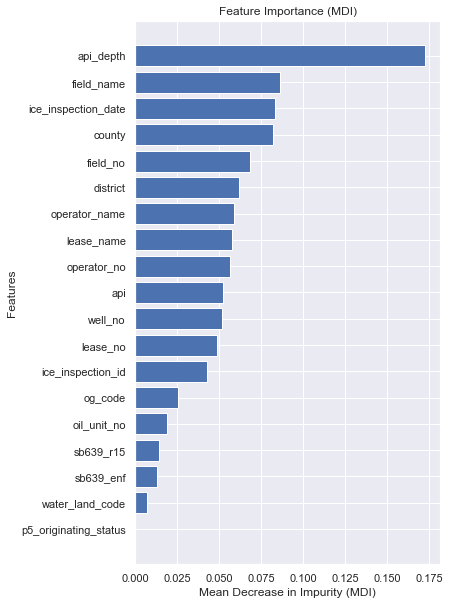

<IPython.core.display.Javascript object>

In [32]:
feature_importance = gb.feature_importances_
sorted_idx = np.argsort(feature_importance)
pos = np.arange(sorted_idx.shape[0]) + .5
fig = plt.figure(figsize=(12, 10))
plt.subplot(1, 2, 1)
plt.barh(pos, feature_importance[sorted_idx], align='center')
plt.yticks(pos, np.array(X.columns)[sorted_idx])
plt.title('Feature Importance (MDI)')
plt.ylabel('Features')
plt.xlabel('Mean Decrease in Impurity (MDI)')
#plt.savefig('figs/gb_feature_importances.png', bbox_inches='tight')
plt.show()

Gather a subset of the data to make predictions with the model and calculate SHAP values.

In [33]:
predict_data = encoded_df.sample(2000).drop(['orig_completion', 'days_active', 'shutin_dt', 'cost_calc'], axis=1)

<IPython.core.display.Javascript object>

In [34]:
gb.predict(predict_data)

array([0.14838909, 0.14798724, 0.15232213, ..., 0.25341868, 0.07985197,
       0.23871149])

<IPython.core.display.Javascript object>

In [35]:
import shap

explainer = shap.TreeExplainer(gb)
shap_values = explainer.shap_values(predict_data)
shap_values2 = explainer(predict_data)

<IPython.core.display.Javascript object>

In [36]:
# shap.initjs()
# shap.force_plot(explainer.expected_value, shap_values, predict_data)

<IPython.core.display.Javascript object>

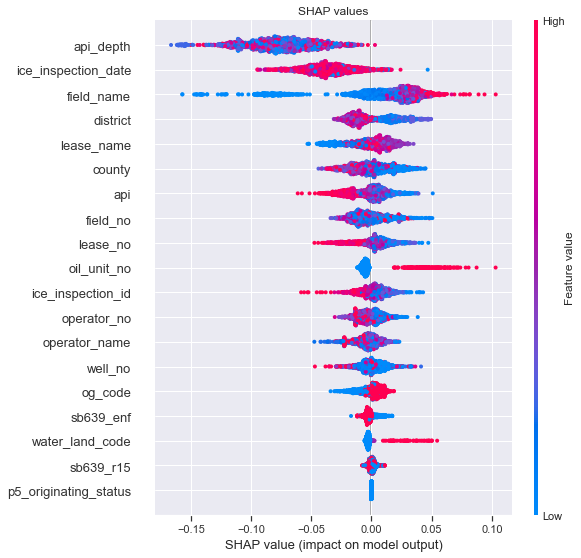

<IPython.core.display.Javascript object>

In [37]:
plt.title('SHAP values')
shap.summary_plot(shap_values, predict_data, show=False)
#plt.savefig('figs/shap_values.png', bbox_inches='tight')

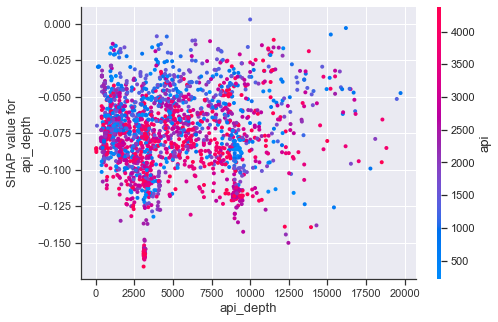

<IPython.core.display.Javascript object>

In [38]:
shap.dependence_plot(13, shap_values, predict_data, show=False)
#plt.savefig('figs/shap_dependence.png', bbox_inches='tight')

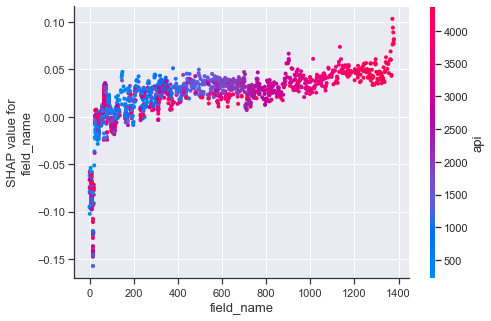

<IPython.core.display.Javascript object>

In [39]:
shap.dependence_plot('field_name', shap_values, predict_data, show=False)
# plt.savefig('figs/shap_dependence_field.png', bbox_inches='tight')

Looking at the feature importances and SHAP values, there are some features such as depth and geographical location (field and district/county of the well) that have a notable effect on the predictions, but because of the accuracy of the model these may not be the best predictors. The partial dependence plot of API depth is fairly scattered, but the plot of field name shows that certain fields (on the left side) have a slightly stronger negative impact on prediction of days active.

Code to find similarity between categorical values using jellyfish.

In [40]:
# import jellyfish as jf 
# leases = data['lease_name'].unique()

# for i in range(0, len(leases)):
#     for j in range(i + 1, len(leases)):
#         dist = jf.jaro_winkler_similarity(leases[i], leases[j])
#         if dist > 0.9:
#             print(leases[i] + ', ' + leases[j] + ', distance ' + str(dist))

<IPython.core.display.Javascript object>

# Exploratory Data Analysis

Correlation matrix with label encoded values. Use Spearman's rank correlation coefficient because of the presence of encoded categorical values (the distance between numeric values is not significant, not ideal for pearson's) and also because it doesn't rely on the data being normalized. (encoded labels)

In [41]:
scaled_df = encoded_df.copy()
scaled_df[['api_depth', 'shutin_dt', 'cost_calc', 'ice_inspection_date', 'days_active']] = scaler.fit_transform(scaled_df[['api_depth', 'shutin_dt', 'cost_calc', 'ice_inspection_date', 'days_active']])

<IPython.core.display.Javascript object>

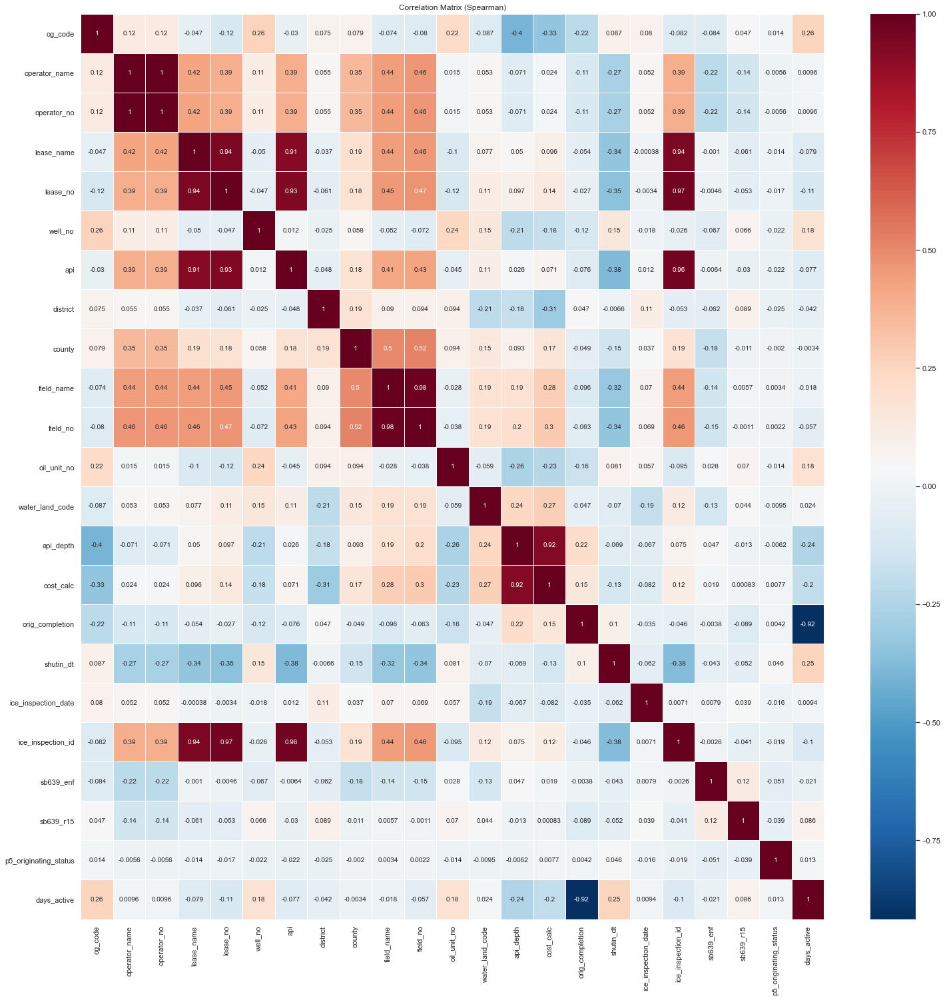

<IPython.core.display.Javascript object>

In [42]:
correlation = scaled_df.corr(method='spearman')
plt.figure(figsize=(25, 25))
plt.title('Correlation Matrix (Spearman)')
sns.heatmap(correlation, 
            xticklabels=correlation.columns,
            yticklabels=correlation.columns,
            cmap='RdBu_r',
            annot=True,
            linewidth=0.5)
# plt.savefig('figs/correlation_matrix.png', bbox_inches='tight')
plt.show()

When looking at the "days_active" column on the far right, there are weak correlations with depth and og_code, but nothing else stands out other than the strong negative correlation with original completion date. However, this is likely due to the fact that most of the well shut in dates are concentrated in recent years, and so as the original completion date becomes more recent, the difference between the two dates decreases in a linear fashion.

Density plot of original completion dates and shut in dates for orphan wells (to help visualize the correlation introduced above).

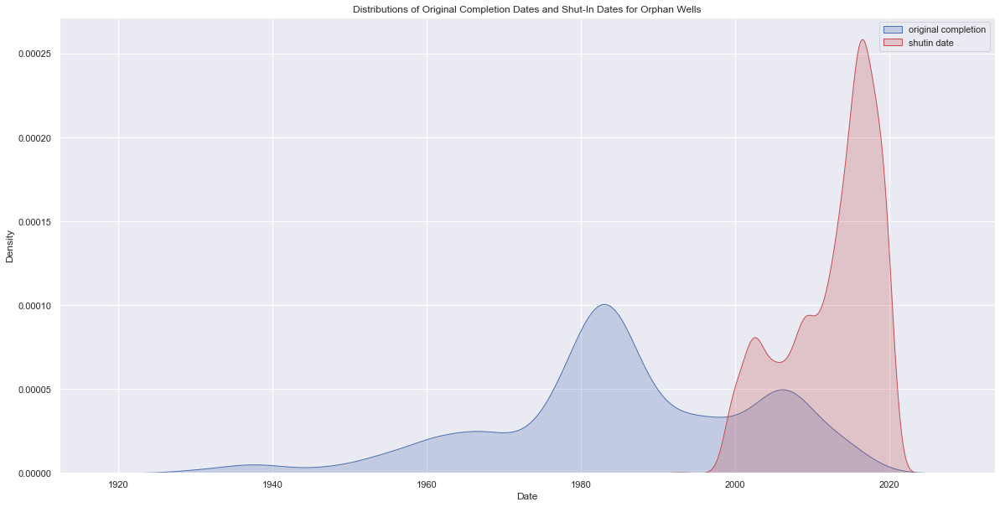

<IPython.core.display.Javascript object>

In [43]:
fig, ax = plt.subplots(figsize=(20, 10))
fig = sns.kdeplot(ax=ax, data=df['orig_completion'], shade=True, color='b', label='original completion')
fig = sns.kdeplot(ax=ax, data=df['shutin_dt'], shade=True, color='r', label='shutin date')
plt.title('Distributions of Original Completion Dates and Shut-In Dates for Orphan Wells')
plt.xlabel('Date')
plt.legend()
# plt.savefig('figs/completions_kde.png', bbox_inches="tight")
plt.show()

Original completions peaked in the 80s and the 2000s, while shut in dates are largely in the 2010s.

Correlation between shut-in date and days that the well was active.

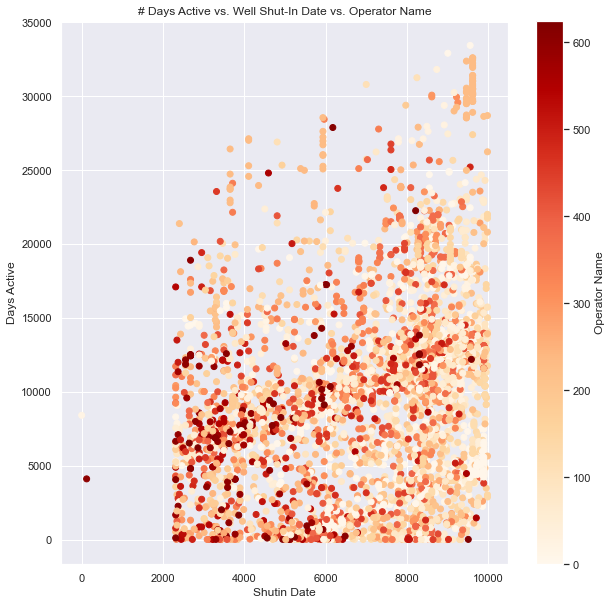

<IPython.core.display.Javascript object>

In [44]:
plt.figure(figsize=(10, 10))
plt.title('# Days Active vs. Well Shut-In Date vs. Operator Name')
plt.scatter(encoded_df['shutin_dt'], encoded_df['days_active'], c=encoded_df['operator_name'], cmap='OrRd')
plt.colorbar(label='Operator Name')
plt.xlabel('Shutin Date')
plt.ylabel('Days Active')
# plt.savefig('figs/shutin_vs_days_active.png')
plt.show()

Correlation between original completions and shut-in date.

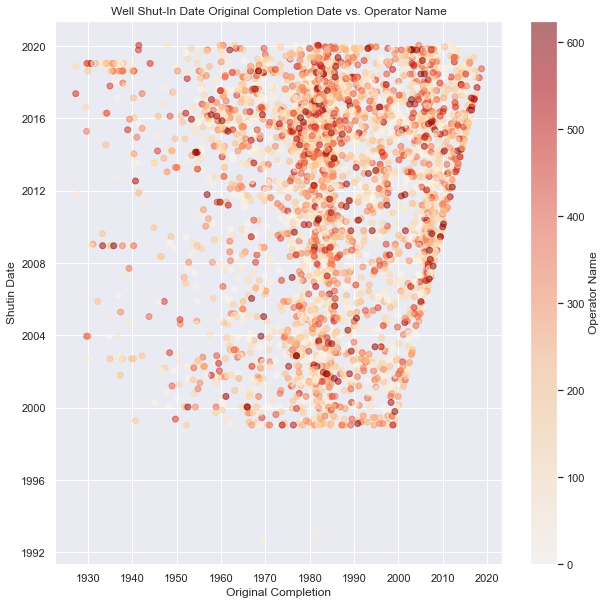

<IPython.core.display.Javascript object>

In [45]:
plt.figure(figsize=(10, 10))
plt.title('Well Shut-In Date Original Completion Date vs. Operator Name')
plt.scatter(df['orig_completion'], df['shutin_dt'], alpha=0.5, c=encoded_df['operator_name'], cmap='OrRd')
plt.colorbar(label='Operator Name')
plt.xlabel('Original Completion')
plt.ylabel('Shutin Date')
#plt.savefig('figs/orig_completion_vs_shutin_date.png')
plt.show()

These plots do not seem to reveal any obvious correlations between operator names, shut in dates, completion dates, and the days active of the well.

Combining time series data (oil and gas prices).

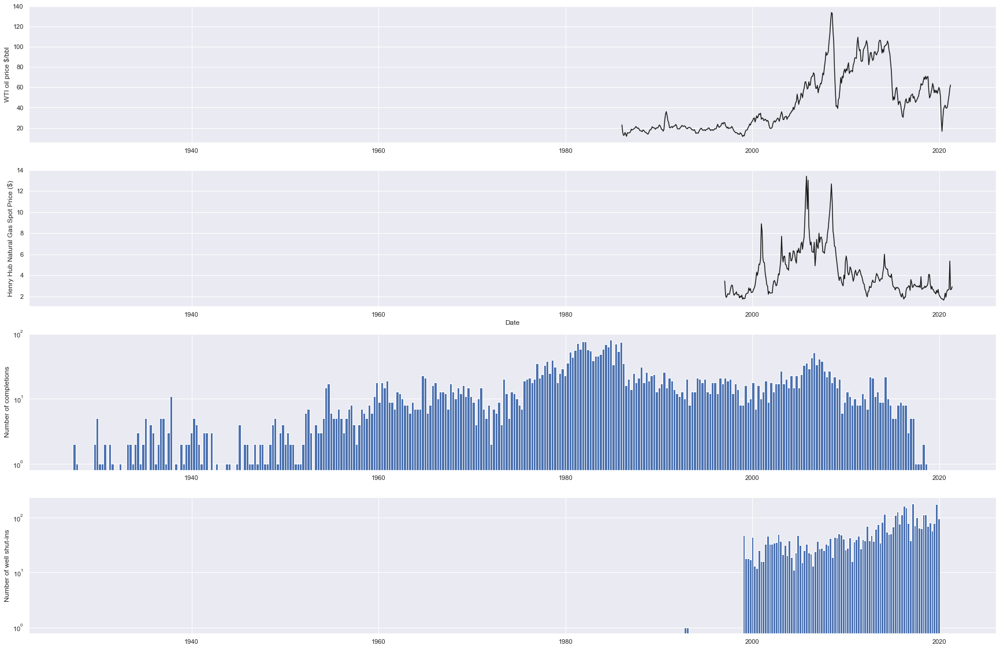

<IPython.core.display.Javascript object>

In [46]:
plt.figure(figsize=(30,20))
plt.title('Oil/Gas Prices and Completions/Shut-In Dates')
ax1 = plt.subplot(411)
plt.plot(oil_prices['date'], oil_prices['price'], c='k')
ax1.set_ylabel('WTI oil price $/bbl')

ax2 = plt.subplot(412, sharex=ax1)
plt.plot(gas_prices['date'], gas_prices['price'], c='k')
ax2.set_xlabel('Date')
ax2.set_ylabel('Henry Hub Natural Gas Spot Price ($)')

ax3 = plt.subplot(413, sharex=ax1)
plt.hist(df['orig_completion'], bins=336)
ax3.set_ylabel('Number of completions')
ax3.set_yscale('log')

ax4 = plt.subplot(414, sharex=ax1)
plt.hist(df['shutin_dt'], bins=118, color='b')
ax4.set_ylabel('Number of well shut-ins')
ax4.set_yscale('log')

# plt.savefig('figs/prices_vs_completions.png', bbox_inches='tight')
plt.show()

At a glance, there does not seem to be any significant correlations between the original completion/shut in dates of the wells and the time series data for oil and gas prices. A decrease in recent oil/gas prices could be leading to more shut-ins?

Which operator names have the highest days active/highest number of orphan wells?

In [47]:
# X = encoded_df['operator_name']
# y = encoded_df['days_active'] 
# plt.figure(figsize=(25, 12))
# plt.scatter(X, y)
# plt.ylim(0, 40_000)
# plt.xticks(rotation=90, fontsize=8)
# plt.show()

<IPython.core.display.Javascript object>

Count up the average active days and number of wells per operator.

In [48]:
operators_days_active = {}
operators_count = {}

for i, row in df.iterrows():
    curr = row['operator_name']
    if curr in operators_days_active:
        operators_days_active[curr] += row['days_active']
        operators_count[curr] += 1
    else:
        operators_days_active[curr] = row['days_active']
        operators_count[curr] = 1

<IPython.core.display.Javascript object>

In [49]:
operators_avgs = {}
for k in operators_days_active.keys():
    operators_avgs[k] = float(operators_days_active[k]) / float(operators_count[k])

<IPython.core.display.Javascript object>

Operators ordered by most active days (descending).

In [50]:
sorted_avgs = sorted(operators_avgs.items(), key=lambda x: x[1], reverse=True)

for i in sorted_avgs:
    print(i[0] + ' ' + str(i[1]) + ', # OF WELLS:' + str(operators_count[i[0]]))
    # print(i[0] + ' ' + str(i[1]) + ' ' + str(operators_count[i]))

WO OPERATING COMPANY 29378.0, # OF WELLS:1
HOPPER, HARLAN 27872.0, # OF WELLS:1
C. O. OIL AND GAS, LLC 26827.514285714286, # OF WELLS:70
PHERE OPERATING INC 26554.5, # OF WELLS:2
STAGE DRILLING CO., INC. 25200.0, # OF WELLS:1
TREK PETROLEUM COMPANY, INC. 24669.333333333332, # OF WELLS:3
TALUS RESOURCES LLC 24220.714285714286, # OF WELLS:7
KODY PETROLEUM CO., INC. 22378.5, # OF WELLS:6
DYERSDALE ENERGY, L.P. 22257.0, # OF WELLS:2
DIAMOND M OIL CO., INC. 22247.0, # OF WELLS:1
M-C PRODUCTION & DRILLING CO,INC 22243.333333333332, # OF WELLS:3
SKINNERGY CO. 21261.0, # OF WELLS:1
SPECTRAL OIL & GAS CORPORATION 20749.5, # OF WELLS:2
MIDWAY OILFIELD CONSTRUCTORS,INC 20449.5, # OF WELLS:2
CHAPMAN OIL CO. 20279.333333333332, # OF WELLS:3
ROLAND OIL COMPANY 19905.5, # OF WELLS:28
MOLDER, TOM 19854.722222222223, # OF WELLS:18
J & J SERVICES COMPANY 19749.0, # OF WELLS:1
TEMPO ENERGY, INC. 19617.0, # OF WELLS:1
BARROW PETROLEUM LLC 19287.6, # OF WELLS:5
KROG PARTNERS, LLC 19173.5, # OF WELLS:10
EAG

<IPython.core.display.Javascript object>

Operators ordered by most number of orphan wells (descending).

In [51]:
sorted_counts = sorted(operators_count.items(), key=lambda x: x[1], reverse=True)

for i in sorted_counts:
    print(i[0] + ', COUNT ' + str(i[1]) + ', AVERAGE:' + str(operators_avgs[i[0]]))

WEATHERLY OIL & GAS, LLC, COUNT 272, AVERAGE:4660.029411764706
DALF ENERGY LLC, COUNT 103, AVERAGE:12998.320388349515
CANADIAN RIVER TRADING CO II, COUNT 92, AVERAGE:12328.923913043478
GALVESTON BAY OPERATING CO LLC, COUNT 86, AVERAGE:11319.732558139534
SOL OIL CO., L.C., COUNT 81, AVERAGE:15517.777777777777
SIANA OIL & GAS, COUNT 72, AVERAGE:10010.111111111111
C. O. OIL AND GAS, LLC, COUNT 70, AVERAGE:26827.514285714286
TRUSTAR OPERATING COMPANY INC., COUNT 61, AVERAGE:6437.393442622951
NHRG INC, COUNT 55, AVERAGE:10241.854545454546
LEVERAGE OPERATING, LLC, COUNT 46, AVERAGE:11639.108695652174
PETRO-SMITH OPERATING LLC, COUNT 44, AVERAGE:9765.59090909091
WILLIAMS DEVILLE OPERATING, INC., COUNT 43, AVERAGE:10654.627906976744
RE-OP CORP., COUNT 42, AVERAGE:6670.9047619047615
PRICKLY PAIR PRODUCTION, COUNT 39, AVERAGE:15075.76923076923
BROWN INDUSTRIAL GAS OP, INC., COUNT 38, AVERAGE:12381.684210526315
IAO ENERGY, LLC, COUNT 37, AVERAGE:10959.81081081081
DOLPHIN PETROLEUM, LP, COUNT 35, 

<IPython.core.display.Javascript object>

In [52]:
numwells = []
numactive = []

for k in operators_avgs.keys():
    numwells.append(operators_count[k])
    numactive.append(operators_avgs[k])

<IPython.core.display.Javascript object>

In [53]:
trunc_df = df.loc[(df['operator_name'] == 'WEATHERLY OIL & GAS, LLC') | (df['operator_name'] == 'DALF ENERGY LLC') | (df['operator_name'] == 'CANADIAN RIVER TRADING CO II') | (df['operator_name'] == 'GALVESTON BAY OPERATING CO LLC') | (df['operator_name'] == 'SOL OIL CO., L.C.') | (df['operator_name'] == 'SIANA OIL & GAS') | (df['operator_name'] == 'C. O. OIL AND GAS, LLC') | (df['operator_name'] == 'TRUSTAR OPERATING COMPANY INC.') | (df['operator_name'] == 'NHRG INC') | (df['operator_name'] == 'LEVERAGE OPERATING, LLC') | (df['operator_name'] == 'PETRO-SMITH OPERATING LLC') | (df['operator_name'] == 'WILLIAMS DEVILLE OPERATING, INC.') | (df['operator_name'] == 'RE-OP CORP.') | (df['operator_name'] == 'PRICKLY PAIR PRODUCTION') | (df['operator_name'] == 'BROWN INDUSTRIAL GAS OP, INC.') | (df['operator_name'] == 'IAO ENERGY, LLC') | (df['operator_name'] == 'DOLPHIN PETROLEUM, LP') | (df['operator_name'] == 'SWEET TEXAS T ENERGY LLC') | (df['operator_name'] == 'PATNO OIL & GAS COMPANY') | (df['operator_name'] == 'GREEN EXPLORATION COMPANY') | (df['operator_name'] == 'DINO OPERATING LLC') | (df['operator_name'] == 'FULLSPIKE ENERGY LLC')]

<IPython.core.display.Javascript object>

We can view the operators with the most number of orphan wells as boxplots, showing the distribution of average active days per orphan well per operator.

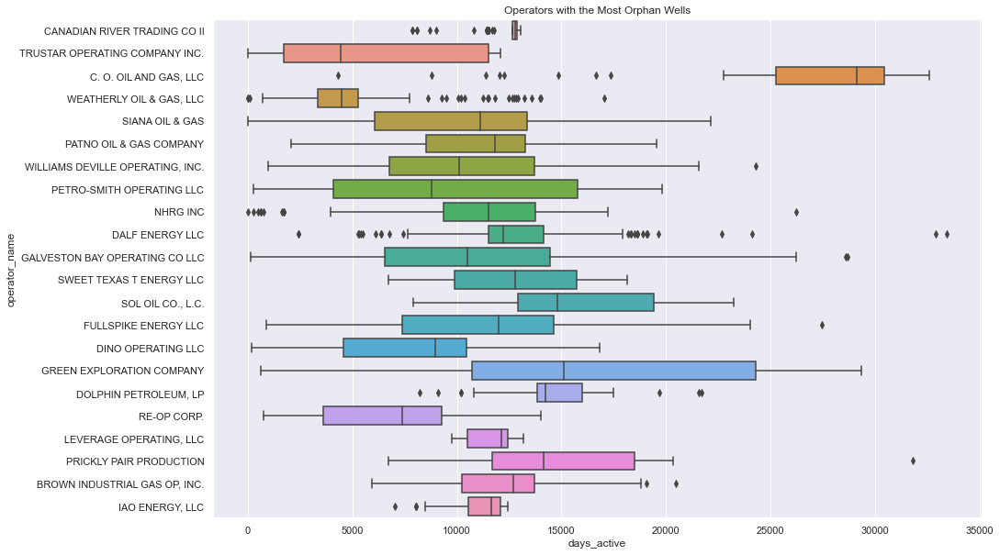

<IPython.core.display.Javascript object>

In [54]:
plt.figure(figsize=(15, 10))
plt.title('Operators with the Most Orphan Wells')
sns.boxplot(x='days_active', y='operator_name', orient='h', data=trunc_df)
plt.savefig('figs/operator_boxplots.png', bbox_inches='tight')

We can also visualize for each unique operator, the number of average active days per well vs the number of wells owned by the operator. It seems that many operators own just one or a few wells, and some of them own a much larger portion of the orphan well population.

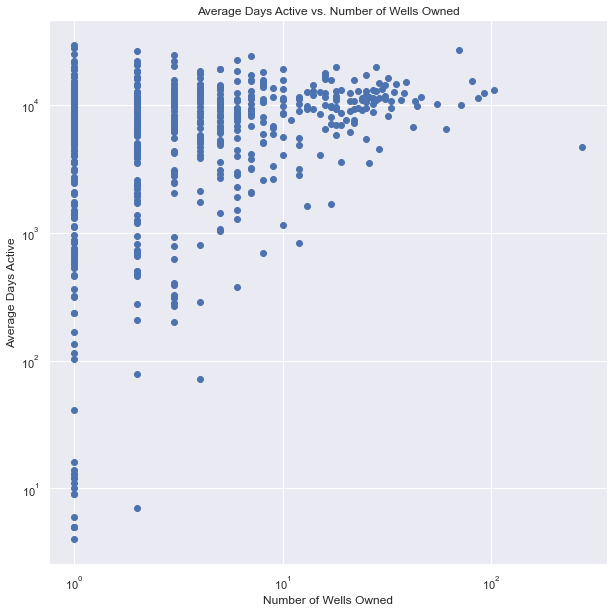

<IPython.core.display.Javascript object>

In [55]:
plt.figure(figsize=(10, 10))
plt.title('Average Days Active vs. Number of Wells Owned')
plt.xlabel('Number of Wells Owned')
plt.ylabel('Average Days Active')
plt.yscale('log')
plt.xscale('log')
plt.scatter(x=numwells, y=numactive)
#plt.savefig('figs/operators_days_active_vs_wells_owned.png', bbox_inches='tight')

In [56]:
len(df['operator_name'].unique())

626

<IPython.core.display.Javascript object>

In [57]:
# most_active_operators = []
# most_active_days = []
# least_active_operators = []
# least_active_days = []

# for i in sorted_avgs[:10]:
#     most_active_operators.append(i[0])
#     most_active_days.append(i[1])

# for i in sorted_avgs[-10:]:
#     least_active_operators.append(i[0])
#     least_active_days.append(i[1])

<IPython.core.display.Javascript object>

# Trying Clustering with numeric data.

Scale the depth and days active for clustering.

In [58]:
scaler = MinMaxScaler()
scaled_data = pd.DataFrame()
scaled_data['api_depth'] = df['api_depth']
scaled_data['days_active'] = df['days_active']
scaled_data = pd.DataFrame(
    scaler.fit_transform(scaled_data.values),
    columns=scaled_data.columns,
    index=scaled_data.index,
)

<IPython.core.display.Javascript object>

Try KMeans clustering on the data.

In [59]:
from sklearn.cluster import KMeans

X = scaled_data[["days_active", "api_depth"]]
cluster = KMeans(n_clusters=6, n_init=50, init="random")
cluster.fit(X)

KMeans(init='random', n_clusters=6, n_init=50)

<IPython.core.display.Javascript object>

In [60]:
X = X.assign(Label=cluster.labels_)

<IPython.core.display.Javascript object>

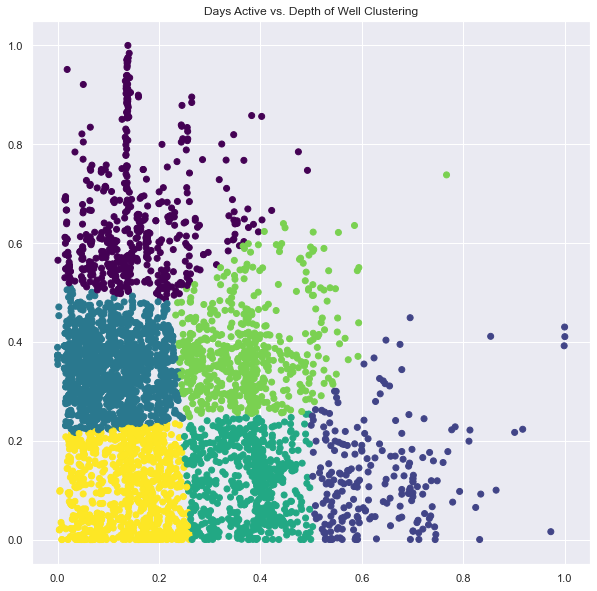

<IPython.core.display.Javascript object>

In [61]:
plt.figure(figsize=(10, 10))
plt.title('Days Active vs. Depth of Well Clustering')
plt.scatter(X['api_depth'], X['days_active'], c=X['Label'], cmap='viridis')

Based on the clustering results there are some clusters that form, let's see if we can visualize a relationship on a log-log plot.

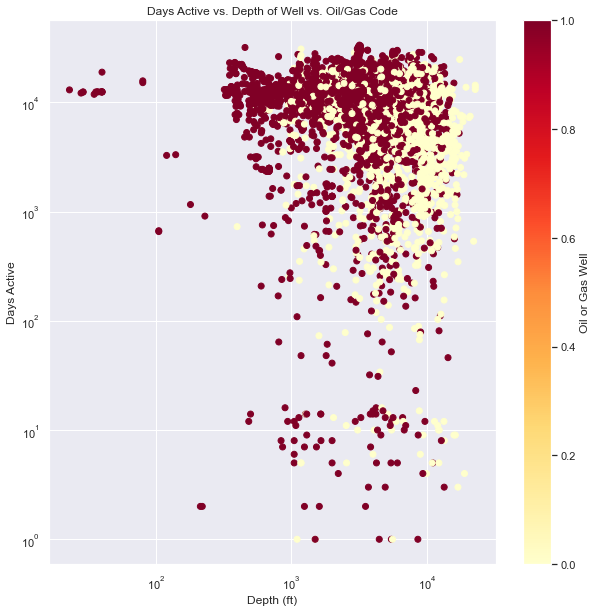

<IPython.core.display.Javascript object>

In [62]:
plt.figure(figsize=(10, 10))
plt.title('Days Active vs. Depth of Well vs. Oil/Gas Code')
plt.scatter(df['api_depth'], df['days_active'], c=df['og_code'], cmap='YlOrRd')
plt.ylabel('Days Active')
plt.xlabel('Depth (ft)')
plt.colorbar(label='Oil or Gas Well')
plt.yscale('log')
plt.xscale('log')
# plt.savefig('figs/days_active_vs_depth.png', bbox_inches='tight')
plt.show()

Viewing the two variables on a log-log plot shows that while the points seem to be concentrated in the upper right portion of the graph, there isn't a definitive correlation between the two, and coloring by oil/gas code doesn't seem to reveal anything either.

# Spatial Visualizations

Count up the # of orphan wells and the total active days of those wells in each county.

In [63]:
county_sums = {}
county_count = {}

for i, row in df.iterrows():
    curr = row['county']
    if curr in county_sums:
        county_sums[curr] += row['days_active']
        county_count[curr] += 1
    else:
        county_sums[curr] = row['days_active']
        county_count[curr] = 1

<IPython.core.display.Javascript object>

Calculate average active days of the wells in each county.

In [64]:
county_avgs = {}
for c in county_sums.keys():
    county_avgs[c] = float(county_sums[c]) / float(county_count[c])

<IPython.core.display.Javascript object>

Read in geographical county data.

In [65]:
import geopandas as gpd
counties = gpd.read_file('countydata/County.shp')
counties['CNTY_NM'] = counties['CNTY_NM'].str.upper()
counties

,FID,CMPTRL_CNT,CNTY_NM,DPS_CNTY_N,FIPS_ST_CN,TXDOT_CNTY,TXDOT_DIST,GID,SHAPE_Leng,SHAPE_Area,geometry
0,1,232,UVALDE,232,48463,232,15,35,2.475515,0.376522,"POLYGON ((-99.50031 29.08711, -99.50147 29.087..."
1,2,143,LAVACA,143,48285,143,13,36,1.927352,0.233741,"POLYGON ((-96.86553 29.63014, -96.86540 29.630..."
2,3,20,BRAZORIA,20,48039,20,12,37,3.042529,0.357074,"POLYGON ((-95.28413 29.59773, -95.28403 29.597..."
3,4,241,WHARTON,241,48481,241,13,38,2.467354,0.263143,"POLYGON ((-96.17527 29.63380, -96.17501 29.633..."
4,5,163,MEDINA,163,48325,163,15,39,2.497139,0.322366,"POLYGON ((-99.41315 29.17354, -99.41315 29.180..."
...,...,...,...,...,...,...,...,...,...,...,...
249,250,148,LIPSCOMB,148,48295,148,4,249,1.979806,0.242396,"POLYGON ((-100.50025 36.49987, -100.49461 36.4..."
250,251,179,OCHILTREE,179,48357,179,4,250,1.967322,0.238827,"POLYGON ((-100.87047 36.49997, -100.86107 36.4..."
251,252,98,HANSFORD,98,48195,99,4,251,1.965479,0.239190,"POLYGON ((-101.08518 36.49987, -101.08515 36.4..."
252,253,119,JACK,119,48237,120,2,198,1.933998,0.230609,"POLYGON ((-97.91818 33.43377, -97.91818 33.433..."


<IPython.core.display.Javascript object>

Append average active days to data from shapefile.

In [66]:
avg_data = []
total_counts = []

for i in range(len(counties)):
    NAME = str(counties.iloc[i]['CNTY_NM'])
    if NAME in county_avgs:
        avg_data.append(county_avgs[NAME])
        total_counts.append(county_count[NAME])
    else:
        avg_data.append(0)
        total_counts.append(0)
counties['avg_days_active'] = avg_data
counties['well_count'] = total_counts

<IPython.core.display.Javascript object>

Plot counties colored by average active days.

Text(109.125, 0.5, 'Latitude')

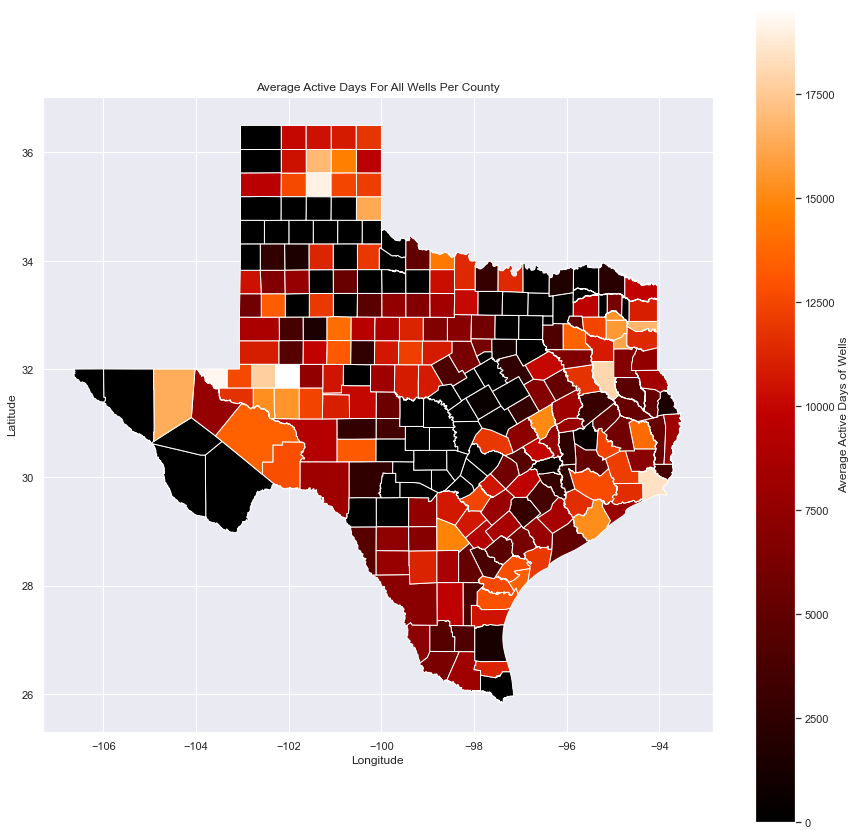

<IPython.core.display.Javascript object>

In [67]:
fig, ax = plt.subplots(figsize=(15,15))
counties.plot(column='avg_days_active', ax=ax, legend=True, cmap='gist_heat', legend_kwds={'label': "Average Active Days of Wells"})
plt.title('Average Active Days For All Wells Per County')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
# plt.savefig('figs/avg_days_counties.png', bbox_inches="tight", dpi=150)

Plot counties colored by orphan wells per county.

Text(109.125, 0.5, 'Latitude')

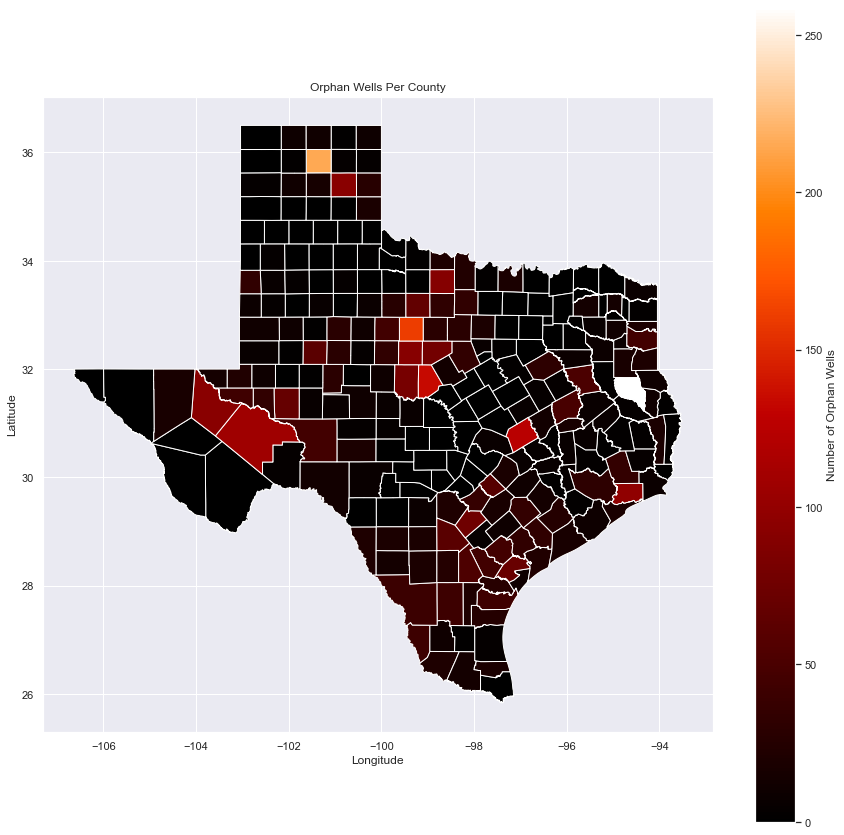

<IPython.core.display.Javascript object>

In [68]:
fig, ax = plt.subplots(figsize=(15,15))
counties.plot(column='well_count', ax=ax, legend=True, cmap='gist_heat', legend_kwds={'label': "Number of Orphan Wells"})
plt.title('Orphan Wells Per County')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
# plt.savefig('figs/avg_wells_counties.png', bbox_inches="tight", dpi=150)

There are some patterns with the orphan wells being concentrated in certain counties. We can try separating out the counties with very few orphans and the ones that contain most of the orphan wells, and see if they have different characteristics and should be placed in separate categories.